In [1]:
import os
import subprocess
import re
import pandas as pd
import numpy as np
import shutil

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.patches import Patch
import matplotlib.patheffects as path_effects
import plotly.express as px
import joypy

from scipy.stats import pearsonr

from biopandas.pdb import PandasPdb

from tqdm import tqdm

import scipy.cluster.hierarchy as sch
from collections import defaultdict

In [2]:
# load data 
df  = pd.read_parquet("../bldb/clean/csv/bldb_dset.parquet")
sbl = df[df.bla_class.str.contains("class_a|class_c|class_d")]

# load tsne
tsne_sbl = pd.read_parquet("../bldb/lowdim/tsne/csv/tsne_sbl_all_models.csv")

# merge 
sbl = sbl.merge(tsne_sbl, on="seq_id", how="inner")

# split
sbl_a = sbl[sbl.bla_class == "class_a"]

# print info
print(sbl_a.columns.to_list())

# plot fx
def do_iscatter(df, x, y, hue, hover_name, hover_data):

    # plot
    fig = px.scatter(df, x=x, y=y,
    height=500, width=600, color=hue,
    hover_name=hover_name, 
    color_discrete_sequence=px.colors.qualitative.Plotly,
    hover_data=hover_data
    )

    fig.update_traces(marker=dict(size=8, line=dict(width=1,color='black')),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.show()

# a fx to export fasta seqs
def export_fasta(df, output_file):
    with open(output_file, 'w') as f:
        for index, row in df.iterrows():
            f.write(f'>{row["seq_id"]}\n')
            f.write(f'{row["seq"]}\n')

['#name', 'seq', 'length', 'filename', 'bla_class', 'protein_name', 'protein_family_filename', 'superfamily', 'protein_family', 'top_fam', 'seq_id', 'ambler_class', 'alternative_protein_name', 'subfamily', 'genpept_id', 'genbank_id', 'pubmed_id', 'seq_url', 'pdb_structures', 'mutants', 'phenotype', 'functional_info', 'source', 'bitscore', 'Domain', 'Phylum', 'Class', 'Order', 'Family', 'Genus', 'Species', 'phylo_group', 'phylo_group_genus', 'phylo_group_sp', 'bla_subclass', 'esm1b', 'esm2_650m', 'esm2_3b', 'carp', 't5xlu50', 'molecular_weight', 'aromaticity', 'instability', 'gravy', 'isoelectric_point', 'entropy', 'helix', 'turn', 'sheet', 'pass_the_filter', 'is_clust_rep_30', 'is_clust_rep_60', 'is_clust_rep_90', 'has_af2_model', 'model', 'mean_plddt', 'resid_plddt', 'entryId', 'gene', 'uniprotAccession', 'uniprotId', 'uniprotDescription', 'taxId', 'organismScientificName', 'uniprotStart', 'uniprotEnd', 'modelCreatedDate', 'latestVersion', 'allVersions', 'isReviewed', 'isReferenceProt

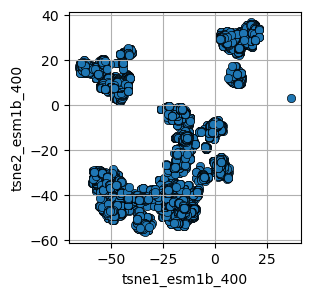

In [3]:
plt.figure(figsize=(3,3))
sns.scatterplot(sbl_a, x="tsne1_esm1b_400", y="tsne2_esm1b_400", edgecolor="k")
plt.grid()

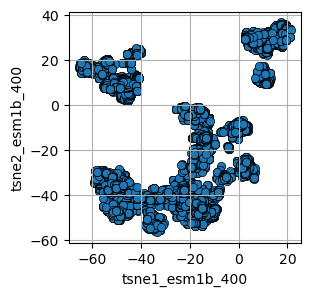

In [4]:
sbl_a = sbl_a[(sbl_a.tsne1_esm1b_400.between(-80,30))]

plt.figure(figsize=(3,3))
sns.scatterplot(sbl_a, x="tsne1_esm1b_400", y="tsne2_esm1b_400", edgecolor="k")
plt.grid()

# seq ident

In [5]:
export_fasta(sbl_a[sbl_a.protein_name == "TEM-1"], "../bldb/clean/fasta/class_a/sim/tem_1.fasta")
export_fasta(sbl_a[sbl_a.protein_name == "BcI-1"], "../bldb/clean/fasta/class_a/sim/bci_1.fasta")
export_fasta(sbl_a[sbl_a.protein_name == "CGA-1"], "../bldb/clean/fasta/class_a/sim/cga_1.fasta")
export_fasta(sbl_a[sbl_a.protein_name == "PenB-1"], "../bldb/clean/fasta/class_a/sim/penb_1.fasta")
export_fasta(sbl_a[sbl_a.protein_name == "AFAM7362-6"], "../bldb/clean/fasta/class_a/sim/afam.fasta")

export_fasta(sbl_a, "../bldb/clean/fasta/class_a/sim/all_class_a.fasta")

In [6]:
# https://www.biostars.org/p/166013/
# https://www.biostars.org/p/9511137/

! cat ../bldb/clean/fasta/class_a/sim/readme 

# mm_cols = ["query", "seq_id", "mmseq_seq_ident", "alnlen", "mismatch", "gapopen", "qstart", "qend", "tstart", "tend", "evalue", "bits"]
# di_cols = ["query", "seq_id", "diamond_seq_ident", "length", "mismatch", "gapopen", "qstart", "qend", "sstart", "send", "evalue", "bitscore"]

tem_diamond = pd.read_csv("../bldb/clean/fasta/class_a/sim/diamond_tem.csv", sep="\t", names=["seq_id", "tem_di"], usecols=[1,2])
tem_mmseqs  = pd.read_csv("../bldb/clean/fasta/class_a/sim/mmseqs_tem.csv", sep="\t", names=["seq_id", "tem_mm"], usecols=[1,2])

seq_ident = pd.merge(tem_diamond, tem_mmseqs, on="seq_id", how="inner")
seq_ident

mmseqs easy-search tem_1.fasta all_class_a.fasta mmseqs_tem.csv tmp --max-seqs 14667 -s 7.5

diamond blastp -d db.dmnd  -q tem_1.fasta -o diamon_tem.csv  --max-target-seqs 14667  --ultra-sensitive


,seq_id,tem_di,tem_mm
0,bldb_013902,100.0,1.000
1,bldb_013977,99.7,0.996
2,bldb_014316,99.7,0.996
3,bldb_014317,99.7,0.996
4,bldb_013908,99.7,0.996
...,...,...,...
13975,bldb_007881,23.8,0.238
13976,bldb_010695,24.4,0.243
13977,bldb_007894,24.4,0.243
13978,bldb_007895,23.3,0.233


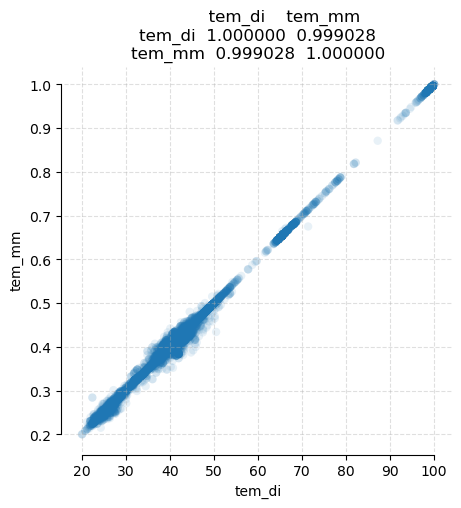

In [7]:
corr = seq_ident.iloc[:, -2:].corr()

plt.figure(figsize=(5,5))
sns.scatterplot(seq_ident, x='tem_di', y='tem_mm', edgecolor="none", alpha=0.1)
plt.title(corr)
plt.grid(alpha=0.4, linestyle="--")
sns.despine(trim=True, offset=2)

In [8]:
sbl_a_copy = sbl_a.copy()
sbl_a_copy = sbl_a_copy.merge(tem_diamond, on="seq_id", how="left")

bci  = pd.read_csv("../bldb/clean/fasta/class_a/sim/diamon_bci.csv", sep="\t", names=["seq_id", "bci"], usecols=[1,2])
cga  = pd.read_csv("../bldb/clean/fasta/class_a/sim/diamon_cga.csv", sep="\t", names=["seq_id", "cga"], usecols=[1,2])
penb = pd.read_csv("../bldb/clean/fasta/class_a/sim/diamon_penb.csv", sep="\t", names=["seq_id", "penb"], usecols=[1,2])
afam = pd.read_csv("../bldb/clean/fasta/class_a/sim/diamon_afam.csv", sep="\t", names=["seq_id", "afam"], usecols=[1,2])

sbl_a_copy = sbl_a_copy.merge(bci, on="seq_id", how="left")
sbl_a_copy = sbl_a_copy.merge(cga, on="seq_id", how="left")
sbl_a_copy = sbl_a_copy.merge(penb, on="seq_id", how="left")
sbl_a_copy = sbl_a_copy.merge(afam, on="seq_id", how="left")

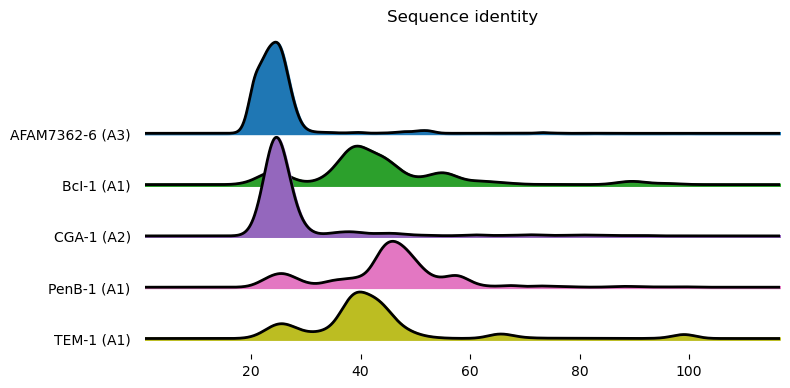

In [9]:
df_id_melt = sbl_a_copy[["tem_di","bci","cga","penb","afam"]]
df_id_melt = pd.melt(df_id_melt, var_name='protein', value_name='seq_ident')

fig, ax = joypy.joyplot(
    df_id_melt, by="protein", column="seq_ident", linecolor="k", colormap=cm.tab10, title="Sequence identity",
    grid=False, overlap=1, figsize=(8,4), linewidth=2, 
    labels=["AFAM7362-6 (A3)","BcI-1 (A1)","CGA-1 (A2)","PenB-1 (A1)","TEM-1 (A1)"])

In [10]:
def plot_seq_ident(x, y, hue, title):
    fig, axs = plt.subplots(2, 1, figsize=(4, 6))
    
    # title
    axs[0].set_title(title)

    # scatter 
    sns.scatterplot(sbl_a_copy.sort_values(hue), x=x, y=y, edgecolor="none", hue=hue, palette="Spectral_r", ax=axs[0])
    axs[0].grid(alpha=0.4, linestyle="--")
    axs[0].set_frame_on(False)
    axs[0].set_yticklabels([])
    axs[0].set_xticklabels([])
    axs[0].set_ylabel("")
    axs[0].set_xlabel("")
    axs[0].tick_params(axis='both', colors='white')
    axs[0].set_axisbelow(True)

    # how to add a cbar
    # https://stackoverflow.com/questions/49761221/make-seaborn-show-a-colorbar-instead-of-a-legend-when-using-hue-in-a-bar-plot
    norm = plt.Normalize(sbl_a_copy[hue].min(), sbl_a_copy[hue].max())
    sm = plt.cm.ScalarMappable(cmap="Spectral_r", norm=norm)
    axs[0].get_legend().remove()
    cbar = axs[0].figure.colorbar(sm, ax=axs[0])
    cbar.set_label("Sequence identity")
    axs[0].set_title(f"{title}")

    # hist
    # https://github.com/mwaskom/seaborn/issues/2344 red kde line 
    sns.histplot(sbl_a_copy, x=hue, element="step", kde=True, line_kws={'color':'black', 'lw': 2}, ax=axs[1])
    axs[1].grid(alpha=0.4, linestyle="--")
    sns.despine(trim=True, offset=2, ax=axs[1])
    axs[1].set_xlabel("Sequence identity")
    axs[1].lines[0].set_color('salmon')
    plt.tight_layout()
    plt.show()

/home/gama/anaconda3/envs/bio/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


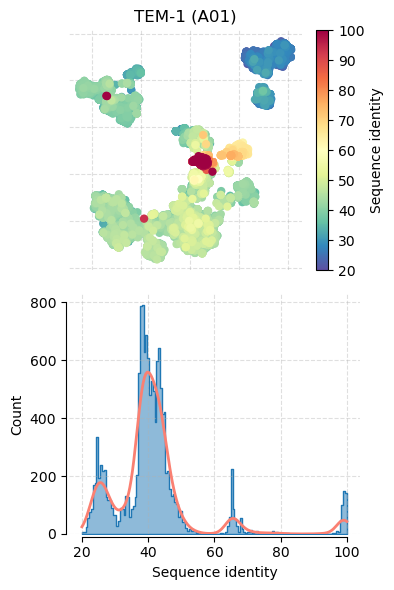

/home/gama/anaconda3/envs/bio/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


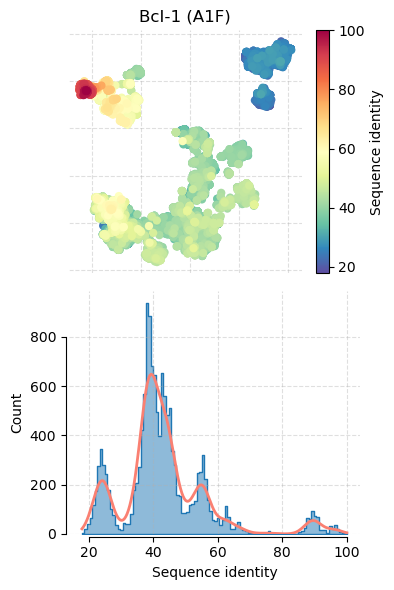

/home/gama/anaconda3/envs/bio/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


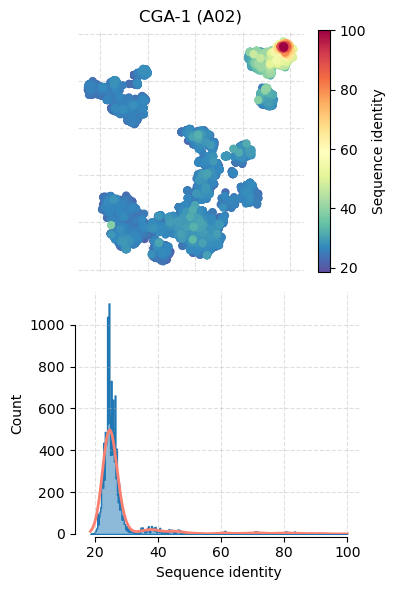

/home/gama/anaconda3/envs/bio/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


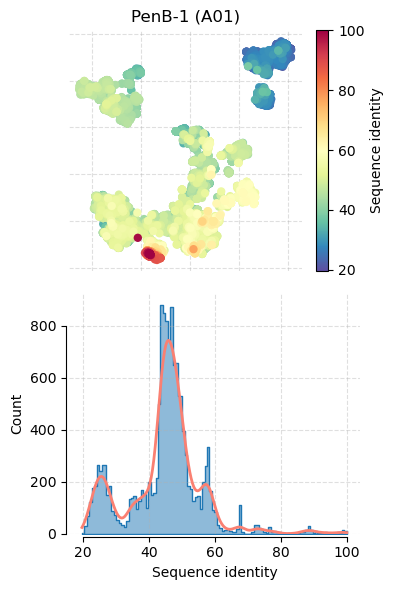

/home/gama/anaconda3/envs/bio/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


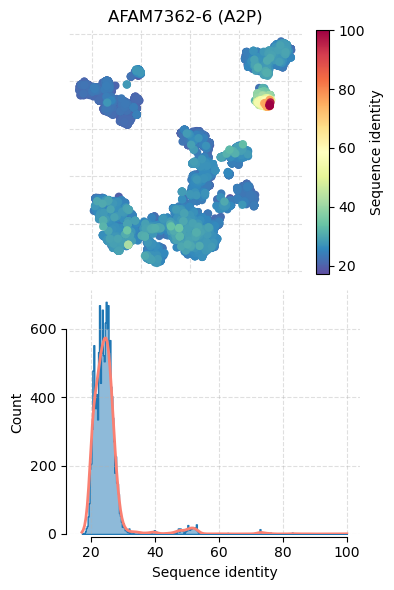

In [11]:
x="tsne1_esm1b_400"
y="tsne2_esm1b_400"

plot_seq_ident(x=x, y=y, hue="tem_di", title="TEM-1 (A01)")
plot_seq_ident(x=x, y=y, hue="bci",    title="BcI-1 (A1F)")
plot_seq_ident(x=x, y=y, hue="cga",    title="CGA-1 (A02)")
plot_seq_ident(x=x, y=y, hue="penb",   title="PenB-1 (A01)")
plot_seq_ident(x=x, y=y, hue="afam",   title="AFAM7362-6 (A2P)")

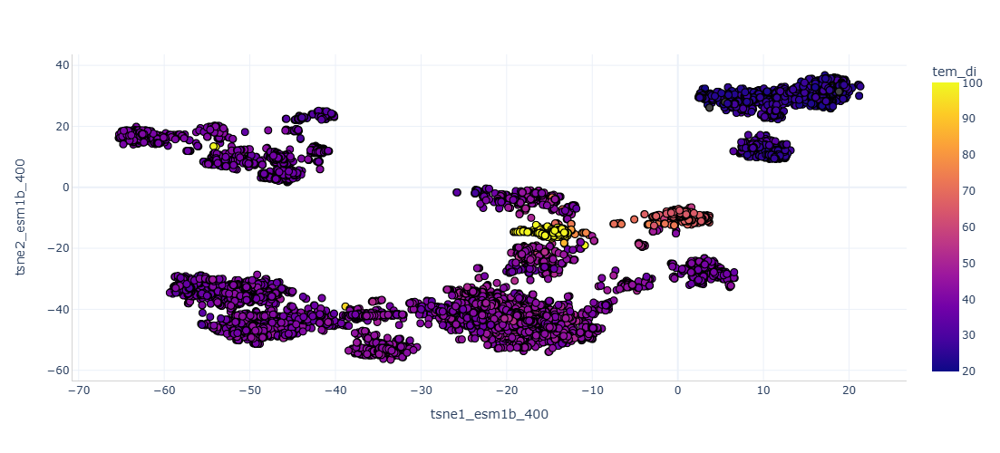

In [12]:
do_iscatter(sbl_a_copy, x=x, y=y, hue="tem_di", hover_name="protein_name", hover_data=["#name", "length"])

In [13]:
# https://www.ncbi.nlm.nih.gov/protein/AHZ59406.1
sbl_a[sbl_a["#name"].str.contains("AHZ59406.1")]["seq"].values[0]

'MGSSHHHHHHSSGLVPRGSHMGAHIVMVDAYKPTKGSGGSGHPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRIDAGQEQLGRRIHYSQNDLVEYSPVTEKHLTDGMTVRELCSAAITMSDNTAANLLLTTIGGPKELTAFLHNMGDHVTRLDRWEPELNEAIPNDERDTTMPAAMATTLRKLLTGELLTLASRQQLIDWMEADKVAGPLLRSALPAGWFIADKSGAGERGSRGIIAALGPDGKPSRIVVIYTTGSQATMDERNRQIAEIGASLIKHWGSGGSGGAMVDTLSGLSSEQGQSGDMTIEEDSATHIKFSKRDEDGKELAGATMELRDSSGKTISTWISDGQVKDFYLYPGKYTFVETAAPDGYEVATAITFTVNEQGQVTVNGKATKGDAHI'

In [14]:
# https://ncbi.nlm.nih.gov/protein/AMK38055.1
sbl_a[sbl_a["#name"].str.contains("AMK38055.1")]["seq"].values[0]

'MGSSHHHHHHSSGLVPRGSHMGATTVHGETVVNGAKLTVTKNLDLVNSNALIPNTDFTFKIEPDTTVNEDGNKFKGVALNTPMTKVTYTNSDKGGSNTKTAEFDFSEVTFEKPGVYYYKVTEEKIDKVPGVSYDTTSYTVQVHVLWNEEQQKPVATYIVGYKEGSKVPIQFKNSLDSTTLTVKKKVSGTGGDRSKDFNFGLTLKANQYYKASEKVMIEKTTKGGQAPVQTEASIDQLYHFTLKDGESIKVTNLPVGVDYVVTEDDYKSEKYTTNVEVSPQDGAVKNIAGNSTEQETSTDKDMTIGSGGSGHPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRIDAGQEQLGRRIHYSQNDLVEYSPVTEKHLTDGMTVRELCSAAITMSDNTAANLLLTTIGGPKELTAFLHNMGDHVTRLDRWEPELNEAIPNDERDTTMPAAMATTLRKLLTGELLTLASRQQLIDWMEADKVAGPLLRSALPAGWFIADKSGAGERGSRGIIAALGPDGKPSRIVVIYTTGSQATMDERNRQIAEIGASLIKHWGSGGSGTDKDMTITFTNKKDAE'

In [15]:
# https://ncbi.nlm.nih.gov/protein/AMK38055.1
sbl_a[sbl_a["#name"].str.contains("BBC91080.1")]["seq"].values[0]

'MMSTFKVLLCGAVLSRVDAGQEQLGRRIHYSQTDLVEYSPVTEKHLTDGMTVRELCSAAITMSDNTAANLLLTTIGGPKELTAFLHNLADHVTRLDRWEPELHQAIPNDERDTTMPAATATTSRKPLTGELLTLASPQQLIDWMEADKVARPLLRSALPAGWFIADKSGARERGSRGIIAALGPDGKPSRIVVIYTTGSQATMDERNTQPAETGASLISWGKLAAN'

# phylo groups 

##### Philippon phylogenetic group = D #####
number of families: 16
['ACI' 'ARL' 'AST' 'BCL' 'BlaC' 'BlaP' 'BlaS' 'CAD' 'CBP' 'FAR' 'MAB'
 'MFO' 'OIH' 'R39' 'ROB' 'SDA']
##### Philippon phylogenetic group = C #####
number of families: 21
['AER' 'CARB' 'CKO' 'FPH' 'GIL' 'HER' 'HMS' 'KLUY' 'LAP' 'LEN' 'OHIO'
 'OKP' 'ORN' 'PAL' 'PLES' 'RUB' 'SCO' 'SHV' 'TEM' 'TER' 'VDA']
##### Philippon phylogenetic group = F #####
number of families: 8
['AXC' 'BKC' 'BOR' 'CzoA' 'GPC' 'L2' 'PAD' 'XCC']
##### Philippon phylogenetic group = B #####
number of families: 4
['BEL' 'GES' 'PME' 'SGM']
##### Philippon phylogenetic group = E #####
number of families: 30
['BES' 'BIC' 'CRH' 'CRP' 'CTX-M' 'CumA' 'DES' 'ERP' 'FONA' 'FRI' 'GRI'
 'IMI' 'KLUA' 'KLUC' 'KLUG' 'KPC' 'LUT' 'MIN' 'OXY' 'PenA' 'PenB' 'PenI'
 'PenL' 'RAHN' 'RIC' 'SED' 'SFC' 'SME' 'SMO' 'VCC']
##### Philippon phylogenetic group = A #####
number of families: 12
['CGA' 'CIA' 'CME' 'CSP' 'CblA' 'CepA' 'CfxA' 'LUS' 'PER' 'TLA' 'TLA2' 'VEB']

GENUS 
- Genus in group A = 61
- Genus in group B = 20
- Genus in group C = 47
- Genus in group D = 54
- Genus in group E = 24
- Genus in group F = 66

SPP  
- spp in group A = 106
- spp in group B = 32
- spp in group C = 90
- spp in group D = 116
- spp in group E = 55
- spp in group F = 151

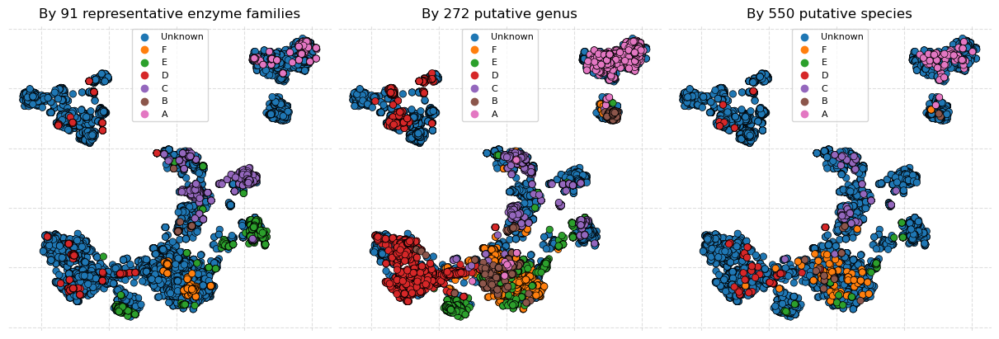

In [16]:
mosaic = """ABC"""

x = "tsne1_esm1b_400"
y = "tsne2_esm1b_400"

ax = plt.figure(figsize=(12,4), constrained_layout = True).subplot_mosaic(mosaic) 

sns.scatterplot(sbl_a.sort_values("phylo_group", ascending=False)       ,x=x, y=y, edgecolor="k", ax=ax["A"], hue="phylo_group"      )
sns.scatterplot(sbl_a.sort_values("phylo_group_genus", ascending=False) ,x=x, y=y, edgecolor="k", ax=ax["B"], hue="phylo_group_genus")
sns.scatterplot(sbl_a.sort_values("phylo_group_sp", ascending=False)    ,x=x, y=y, edgecolor="k", ax=ax["C"], hue="phylo_group_sp"   )

ax["A"].set_title(f"By 91 representative enzyme families")
ax["B"].set_title(f"By 272 putative genus")
ax["C"].set_title(f"By 550 putative species")

for i in "ABC":
    ax[i].grid(alpha=0.4, linestyle="--")
    ax[i].set_frame_on(False)
    ax[i].legend(frameon=True, fontsize=8)
    ax[i].set_yticklabels([])
    ax[i].set_xticklabels([])
    ax[i].set_ylabel("")
    ax[i].set_xlabel("")
    ax[i].tick_params(axis='both', colors='white')
    ax[i].set_axisbelow(True)

In [17]:
sbl_a.phylo_group_genus.value_counts()

phylo_group_genus
Unknown    7085
D          2430
F          1359
A          1205
E          1089
C           821
B           677
Name: count, dtype: int64

In [18]:
sbl_a.phylo_group_sp.value_counts()

phylo_group_sp
Unknown    14114
A            133
F            132
C             95
D             81
E             81
B             30
Name: count, dtype: int64

In [20]:
sbl_a.phylo_group_sp.value_counts().sum()

14666

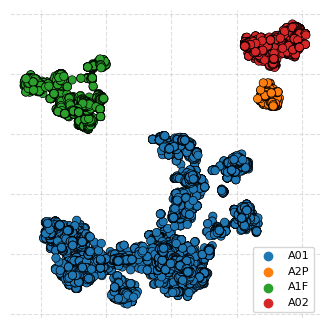

In [18]:
# create groups 
filters = [  
    (sbl_a.tsne1_esm1b_400.between(-70,-35) & sbl_a.tsne2_esm1b_400.between(0,30)),
    (sbl_a.tsne1_esm1b_400.between(0,25)   & sbl_a.tsne2_esm1b_400.between(20,40)),
    (sbl_a.tsne1_esm1b_400.between(6,14)   & sbl_a.tsne2_esm1b_400.between(9,28)),
]

values = ["A1F", "A02", "A2P"]

sbl_a["group"] = np.select(filters, values)
sbl_a["group"] = sbl_a["group"].str.replace("0", "A01")
sbl_a["group"] = sbl_a.group.str.replace("AA012", "A02")

# plot 
plt.figure(figsize=(4,4))
ax=sns.scatterplot(sbl_a, x="tsne1_esm1b_400", y="tsne2_esm1b_400", hue="group", edgecolor="k")
ax.grid(alpha=0.4, linestyle="--")
ax.set_frame_on(False)
ax.legend(frameon=True, fontsize=8)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_ylabel("")
ax.set_xlabel("")
ax.tick_params(axis='both', colors='white')
ax.set_axisbelow(True)

Text(0.5, 1.0, 'rep90')

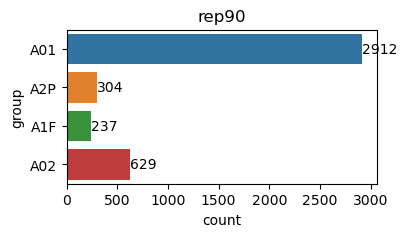

In [19]:
plt.figure(figsize=(4,2))
ax=sns.countplot(sbl_a[sbl_a.is_clust_rep_90 == "yes"], y="group")
ax.bar_label(ax.containers[0])
plt.title("rep90")

In [20]:
# select subsets 
df_a01 = sbl_a[(sbl_a.is_clust_rep_90 == "yes") & (sbl_a.group == "A01")]
df_a1f = sbl_a[(sbl_a.is_clust_rep_90 == "yes") & (sbl_a.group == "A1F")]
df_a02 = sbl_a[(sbl_a.is_clust_rep_90 == "yes") & (sbl_a.group == "A02")]
df_a2p = sbl_a[(sbl_a.is_clust_rep_90 == "yes") & (sbl_a.group == "A2P")]

print(f"seqs in A01: {len(df_a01)}")
print(f"seqs in A2P: {len(df_a2p)}")
print(f"seqs in A1F: {len(df_a1f)}")
print(f"seqs in A02: {len(df_a02)}")

# export to build cons
export_fasta(df_a01,"../bldb/clean/fasta/class_a/a01_rep90.fasta")
export_fasta(df_a2p,"../bldb/clean/fasta/class_a/a2p_rep90.fasta")
export_fasta(df_a1f,"../bldb/clean/fasta/class_a/a1f_rep90.fasta")
export_fasta(df_a02,"../bldb/clean/fasta/class_a/a02_rep90.fasta")

seqs in A01: 2912
seqs in A2P: 304
seqs in A1F: 237
seqs in A02: 629


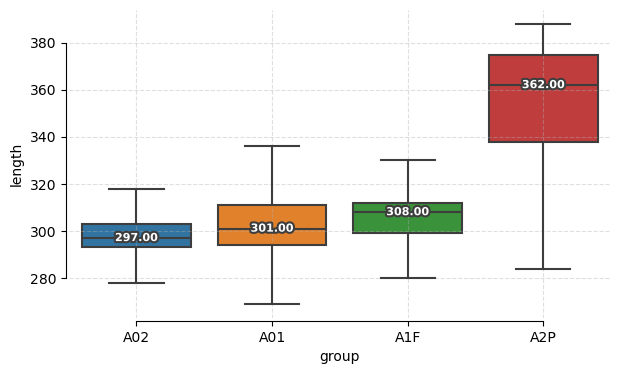

In [21]:
# from https://stackoverflow.com/questions/38649501/labeling-boxplot-in-seaborn-with-median-value
def add_median_labels(ax, fmt='.2f'):
   
    lines = ax.get_lines()
    boxes = [c for c in ax.get_children() if type(c).__name__ == 'PathPatch']
    lines_per_box = int(len(lines) / len(boxes))
    
    for median in lines[4:len(lines):lines_per_box]:
        x, y = (data.mean() for data in median.get_data())
        
        # choose value depending on horizontal or vertical plot orientation
        value = x if (median.get_xdata()[1] - median.get_xdata()[0]) == 0 else y
        text = ax.text(x, y, f'{value:{fmt}}', ha='center', va='center',fontweight='bold', color='white', fontsize=8)
        
        # create median-colored border around white text for contrast
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground=median.get_color()),
            path_effects.Normal()])

plt.figure(figsize=(7,4))
ax = sns.boxplot(sbl_a[sbl_a.is_clust_rep_90 == "yes"], 
    y="length", x="group", order=["A02","A01","A1F","A2P"],
    showfliers=False)
add_median_labels(ax)
sns.despine(trim=True, offset=2)
ax.grid(alpha=0.4, linestyle="--")

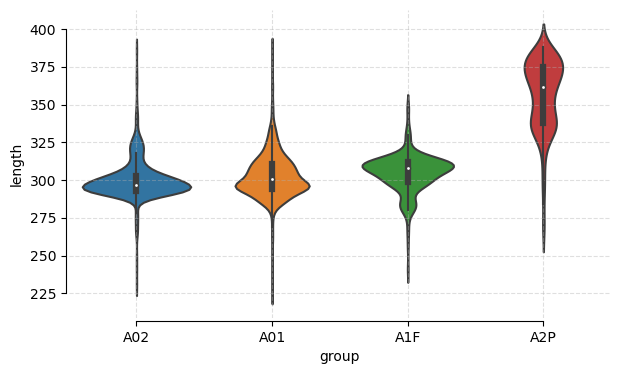

In [22]:
plt.figure(figsize=(7,4))
ax = sns.violinplot(sbl_a[sbl_a.is_clust_rep_90 == "yes"], 
    y="length", x="group", order=["A02","A01","A1F","A2P"],
    showfliers=False)
sns.despine(trim=True, offset=2)
ax.grid(alpha=0.4, linestyle="--")

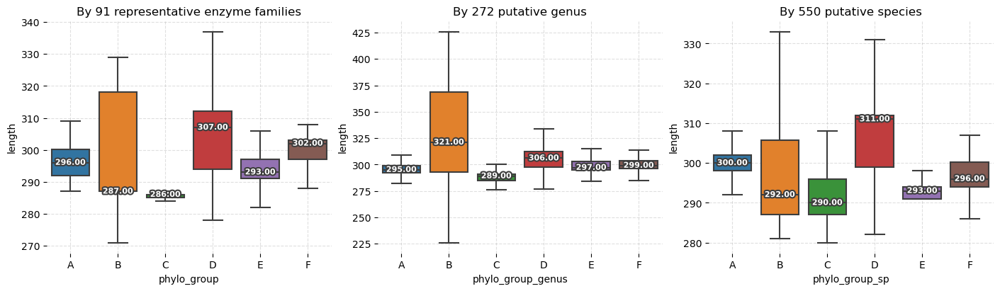

In [24]:
ax = plt.figure(figsize=(14,4), constrained_layout = True).subplot_mosaic(mosaic) 

order=["A","B","C","D","E","F"]
sns.boxplot(sbl_a[~sbl_a.phylo_group.str.contains("Unk")],       x="phylo_group",       y="length",showfliers=False, ax=ax["A"], order=order)
sns.boxplot(sbl_a[~sbl_a.phylo_group_genus.str.contains("Unk")], x="phylo_group_genus", y="length",showfliers=False, ax=ax["B"], order=order)
sns.boxplot(sbl_a[~sbl_a.phylo_group_sp.str.contains("Unk")],    x="phylo_group_sp",    y="length",showfliers=False, ax=ax["C"], order=order)

ax["A"].set_title(f"By 91 representative enzyme families")
ax["B"].set_title(f"By 272 putative genus")
ax["C"].set_title(f"By 550 putative species")

for i in "ABC":
    ax[i].grid(alpha=0.4, linestyle="--")
    ax[i].set_frame_on(False)
    ax[i].tick_params(axis='both', colors='black')
    ax[i].set_axisbelow(True)
    add_median_labels(ax[i])

In [25]:
def do_iscatter2(df, x, y, hue, hover_name, hover_data):
    
    my_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
    my_colors[0] = "#FFFFFF"

    fig = px.scatter(df, x=x, y=y,height=550, width=650, color=hue, 
    hover_name=hover_name, opacity=1, color_discrete_sequence=my_colors,
    hover_data=hover_data)

    fig.update_traces(marker=dict(size=10, line=dict(width=2,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    fig.update_yaxes(showline=False, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=False, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(title_text="", showticklabels=False)
    fig.update_yaxes(title_text="", showticklabels=False)
    
    white_marker_style = {'marker': {'opacity': 0.005}}
    for i, color in enumerate(my_colors):
        if color == "#FFFFFF":
            fig.update_traces(white_marker_style, selector=dict(marker_color=color))
    
    fig.show() 

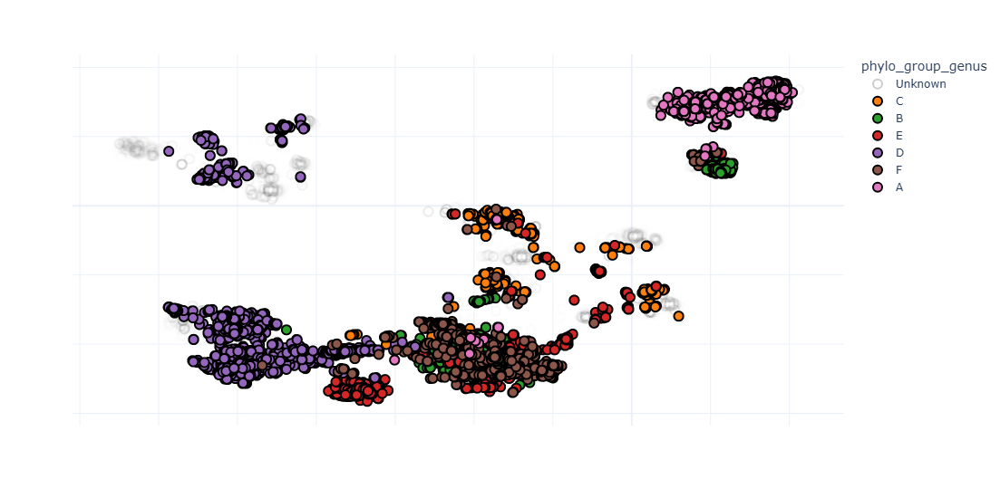

In [26]:
do_iscatter2(df=sbl_a, x="tsne1_esm1b_400", y="tsne2_esm1b_400", hue="phylo_group_genus", 
            hover_name="protein_name", hover_data=["#name"])

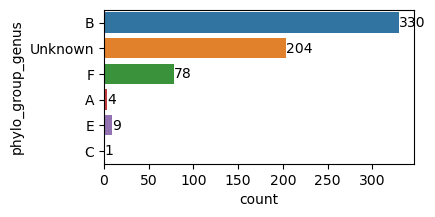

In [27]:
plt.figure(figsize=(4,2))
ax=sns.countplot(sbl_a[sbl_a.group == "A2P"], y="phylo_group_genus")
ax.bar_label(ax.containers[0]);

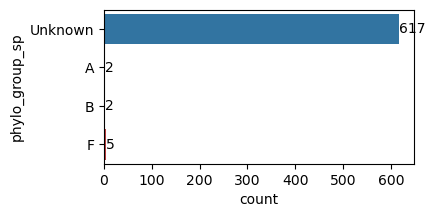

In [28]:
plt.figure(figsize=(4,2))
ax=sns.countplot(sbl_a[sbl_a.group == "A2P"], y="phylo_group_sp")
ax.bar_label(ax.containers[0]);

# structure 

[Text(0, 0, '6772'), Text(0, 0, '7894')]

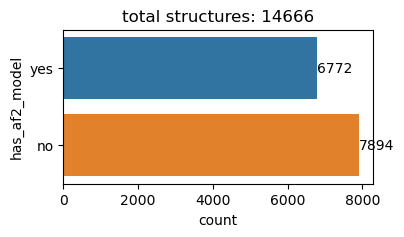

In [30]:
plt.figure(figsize=(4,2))
ax=sns.countplot(sbl_a, y="has_af2_model")
n = len(sbl_a)
plt.title(f"total structures: {n}")
ax.bar_label(ax.containers[0])

[Text(0, 0, '4842'), Text(0, 0, '369'), Text(0, 0, '523'), Text(0, 0, '1038')]

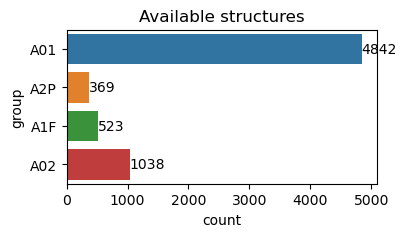

In [33]:
af2 = sbl_a[sbl_a.has_af2_model == "yes"]
af2 = af2.reset_index(drop=True)

plt.figure(figsize=(4,2))
ax=sns.countplot(af2, y="group")
plt.title("Available structures")
ax.bar_label(ax.containers[0])

[Text(0, 0, '1700'), Text(0, 0, '203'), Text(0, 0, '113'), Text(0, 0, '421')]

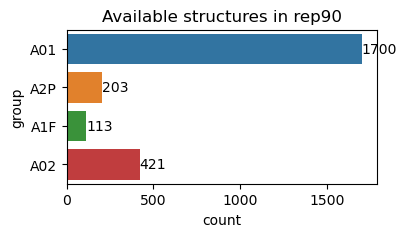

In [34]:
plt.figure(figsize=(4,2))
ax=sns.countplot(af2[af2.is_clust_rep_90=="yes"], y="group")
plt.title("Available structures in rep90")
ax.bar_label(ax.containers[0])

In [35]:
# take rep90 
af2_90 = af2[af2.is_clust_rep_90=="yes"]
af2_90 = af2_90.reset_index(drop=True)

# take subsets 
af2_90_a01 = af2_90[af2_90.group=="A01"]
af2_90_a2p = af2_90[af2_90.group=="A2P"]
af2_90_a1f = af2_90[af2_90.group=="A1F"]
af2_90_a02 = af2_90[af2_90.group=="A02"]

# enlist 
# names_a01 = af2_90_a01.sample(100, random_state=37).model.to_list() example
names_a01 = af2_90_a01.model.to_list() 
names_a2p = af2_90_a2p.model.to_list() 
names_a1f = af2_90_a1f.model.to_list() 
names_a02 = af2_90_a02.model.to_list() 

models = names_a01 + names_a2p + names_a1f + names_a02

print(f"seqs in A01: {len(names_a01)}")
print(f"seqs in A2P: {len(names_a2p)}")
print(f"seqs in A1F: {len(names_a1f)}")
print(f"seqs in A02: {len(names_a02)}")
print(f"total:       {len(models)}")

seqs in A01: 1700
seqs in A2P: 203
seqs in A1F: 113
seqs in A02: 421
total:       2437


In [36]:
#! mkdir ../bldb/af2/class_a_rep90_rand100

# set dirs 
pdb_files = "../bldb/af2/class_a/"
clone_dir = "../bldb/af2/class_a/rep90_rand100/"

In [41]:
# run the same for 2437 pdbs 

# copy the files 
#for pdb in tqdm(models, desc="Working"):
#    filename = os.path.join(pdb_files, pdb)
#    if os.path.exists(filename):
#        shutil.copy(filename, clone_dir)

In [37]:
# https://mmseqs.com/latest/userguide.pdf
! cat ../bldb/af2/class_a/rep90_rand100/search/readme

# inside db dir 
foldseek createdb ../../*.pdb db

foldseek easy-search db/db db/db foldseek_results_rand400_all.csv tmp2 --alignment-type 1 --format-output "query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob" --exhaustive-search 1 --tmscore-threshold 0.0 -e inf



In [38]:
foldseek_cols = ['query', 'target', 'rmsd', 'alntmscore', 'fident', 'lddt', 'evalue', 'bits', 'prob']

foldseek = pd.read_csv("../bldb/af2/class_a/rep90_rand100/search/foldseek_results_rand400_all.csv", sep="\t", names=foldseek_cols)
foldseek

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,AF-A0A246BAJ8-F1-model_v4.pdb,AF-A0A246BAJ8-F1-model_v4.pdb,0.01452,1.0000,1.000,1.0000,1.0000,0,0.000
1,AF-A0A246BAJ8-F1-model_v4.pdb,AF-A0A840KBG8-F1-model_v4.pdb,0.61430,0.9859,0.583,0.9604,0.9841,98,0.999
2,AF-A0A246BAJ8-F1-model_v4.pdb,AF-A0A0Q5ZQW2-F1-model_v4.pdb,0.65900,0.9848,0.563,0.9500,0.9826,98,0.999
3,AF-A0A246BAJ8-F1-model_v4.pdb,AF-A0A1G9RST5-F1-model_v4.pdb,0.71430,0.9873,0.568,0.9478,0.9816,97,0.999
4,AF-A0A246BAJ8-F1-model_v4.pdb,AF-A0A3G6RT29-F1-model_v4.pdb,0.74880,0.9827,0.597,0.9612,0.9800,98,0.999
...,...,...,...,...,...,...,...,...,...
159995,AF-A0A059WXI2-F1-model_v4.pdb,AF-A0A1M2ZEY2-F1-model_v4.pdb,1.88300,0.8761,0.195,0.7509,0.7550,86,0.993
159996,AF-A0A059WXI2-F1-model_v4.pdb,AF-T0HPJ5-F1-model_v4.pdb,2.15900,0.8812,0.188,0.7432,0.7545,86,0.993
159997,AF-A0A059WXI2-F1-model_v4.pdb,AF-A0A0K1PTJ4-F1-model_v4.pdb,1.78300,0.7806,0.223,0.7240,0.7539,73,0.956
159998,AF-A0A059WXI2-F1-model_v4.pdb,AF-A0A1H7RH27-F1-model_v4.pdb,1.99500,0.8719,0.205,0.7492,0.7520,85,0.992


In [39]:
# rename the files in the df 
def rename_file(name, names_lists):
    for prefix, names_list in names_lists.items():
        if name in names_list:
            return f"{prefix}-{name}"
    return name

# format list as dict 
names_lists = {"A01": names_a01, "A2P": names_a2p, "A1F": names_a1f, "A02": names_a02}

# apply the rename-fx 
foldseek["query"]  = foldseek["query"].apply(lambda x: rename_file(x, names_lists))
foldseek["target"] = foldseek["target"].apply(lambda x: rename_file(x, names_lists))
foldseek

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,A02-AF-A0A246BAJ8-F1-model_v4.pdb,A02-AF-A0A246BAJ8-F1-model_v4.pdb,0.01452,1.0000,1.000,1.0000,1.0000,0,0.000
1,A02-AF-A0A246BAJ8-F1-model_v4.pdb,A02-AF-A0A840KBG8-F1-model_v4.pdb,0.61430,0.9859,0.583,0.9604,0.9841,98,0.999
2,A02-AF-A0A246BAJ8-F1-model_v4.pdb,A02-AF-A0A0Q5ZQW2-F1-model_v4.pdb,0.65900,0.9848,0.563,0.9500,0.9826,98,0.999
3,A02-AF-A0A246BAJ8-F1-model_v4.pdb,A02-AF-A0A1G9RST5-F1-model_v4.pdb,0.71430,0.9873,0.568,0.9478,0.9816,97,0.999
4,A02-AF-A0A246BAJ8-F1-model_v4.pdb,A02-AF-A0A3G6RT29-F1-model_v4.pdb,0.74880,0.9827,0.597,0.9612,0.9800,98,0.999
...,...,...,...,...,...,...,...,...,...
159995,A01-AF-A0A059WXI2-F1-model_v4.pdb,A2P-AF-A0A1M2ZEY2-F1-model_v4.pdb,1.88300,0.8761,0.195,0.7509,0.7550,86,0.993
159996,A01-AF-A0A059WXI2-F1-model_v4.pdb,A2P-AF-T0HPJ5-F1-model_v4.pdb,2.15900,0.8812,0.188,0.7432,0.7545,86,0.993
159997,A01-AF-A0A059WXI2-F1-model_v4.pdb,A2P-AF-A0A0K1PTJ4-F1-model_v4.pdb,1.78300,0.7806,0.223,0.7240,0.7539,73,0.956
159998,A01-AF-A0A059WXI2-F1-model_v4.pdb,A2P-AF-A0A1H7RH27-F1-model_v4.pdb,1.99500,0.8719,0.205,0.7492,0.7520,85,0.992


In [40]:
def plot_clustermap(df, values_col, cbar_label, palette):
    # create a sim matrix 
    df_sim = df.pivot(index='query', columns='target', values=values_col)

    # create a color palette and handles
    colors = df_sim.index.str[:3].map({
        "A01": "royalblue", 
        "A02": "orange", 
        "A1F": "limegreen", 
        "A2P": "black"})
    lut = dict(zip(df_sim.index.str[:3].to_list(), colors))
    handles = [Patch(facecolor = lut[name]) for name in lut]

    # plot
    g = sns.clustermap(
        figsize=(6, 6),
        data = df_sim.to_numpy().astype(float), 
        method = "ward", metric = "euclidean", 
        annot = False, cmap = palette,
        row_colors = colors.to_list(), 
        col_colors = colors.to_list(), 
        xticklabels = False, yticklabels = False, # False, df_sim.index
        cbar_kws={"label": cbar_label}, 
        cbar_pos = (0.03, 0.77, 0.05, 0.2))

    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize = 5)
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_xticklabels(), fontsize = 5)
    plt.legend(
        handles, lut, 
        title = "Subclass", loc = "best", 
        frameon = False, ncol = 1,
        bbox_to_anchor = (1, 1), 
        bbox_transform = plt.gcf().transFigure, 
        prop = {'size': 8})

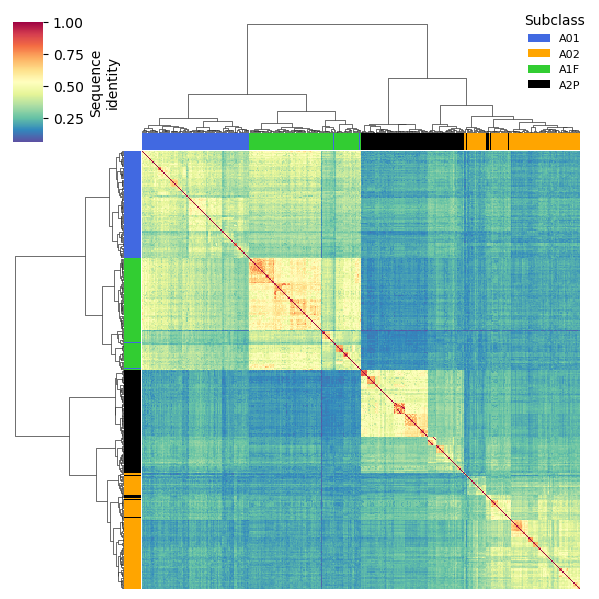

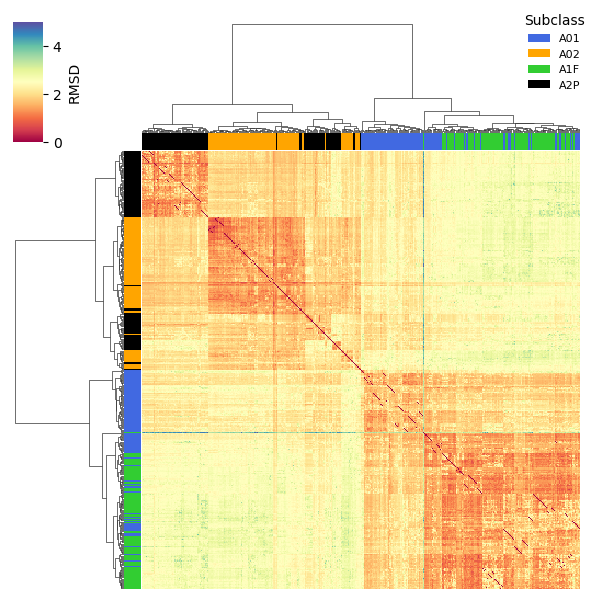

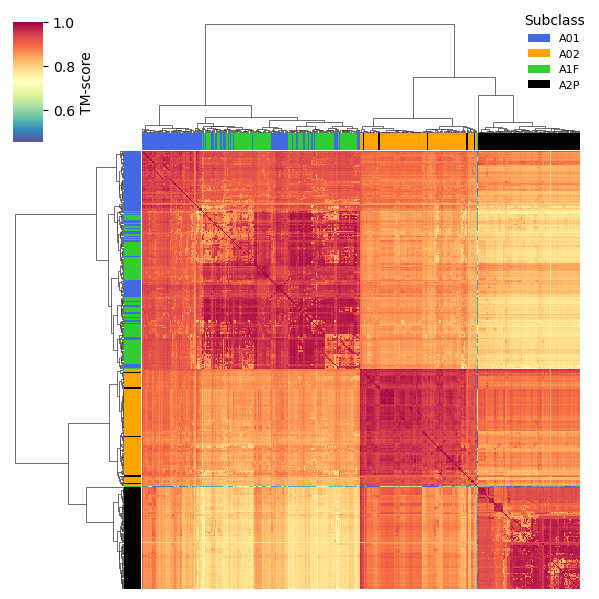

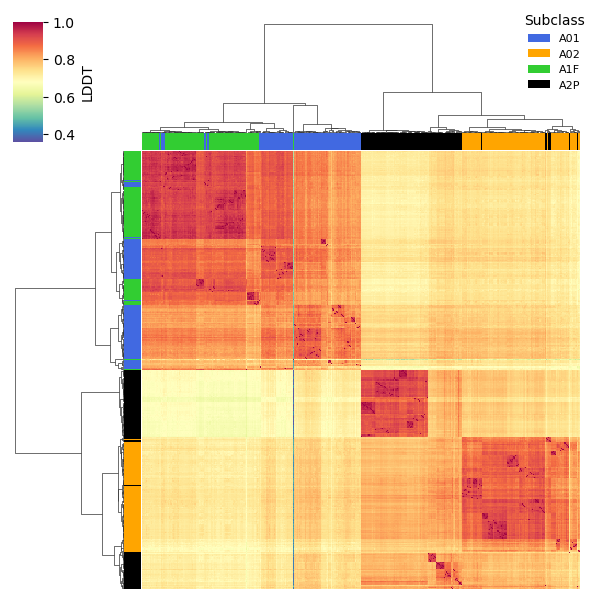

In [41]:
plot_clustermap(foldseek, 'fident', 'Sequence\nidentity', "Spectral_r")
plot_clustermap(foldseek, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(foldseek, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(foldseek, 'lddt', 'LDDT', "Spectral_r")

In [42]:
# A1F-AF-A0A2A8HHI3-F1-model_v4.pdb	 appears to be a outlier 
# https://alphafold.ebi.ac.uk/entry/A0A2A8HHI3
foldseek[foldseek.fident < 1.0].sort_values("prob").head()

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
54399,A2P-AF-A0A196M8N7-F1-model_v4.pdb,A1F-AF-A0A2A8HHI3-F1-model_v4.pdb,4.085,0.5494,0.121,0.3940,0.3890,32,0.106
17199,A2P-AF-Q1GWS4-F1-model_v4.pdb,A1F-AF-A0A2A8HHI3-F1-model_v4.pdb,4.412,0.4718,0.075,0.3860,0.3925,32,0.106
146799,A2P-AF-A0A0A7PJX3-F1-model_v4.pdb,A1F-AF-A0A2A8HHI3-F1-model_v4.pdb,4.147,0.5360,0.100,0.3941,0.3885,32,0.106
21999,A2P-AF-A0A1M2ZEY2-F1-model_v4.pdb,A1F-AF-A0A2A8HHI3-F1-model_v4.pdb,4.136,0.5514,0.099,0.3978,0.3890,32,0.106
127199,A2P-AF-A0A0P0D6Q1-F1-model_v4.pdb,A1F-AF-A0A2A8HHI3-F1-model_v4.pdb,4.203,0.5422,0.070,0.3786,0.3899,32,0.106


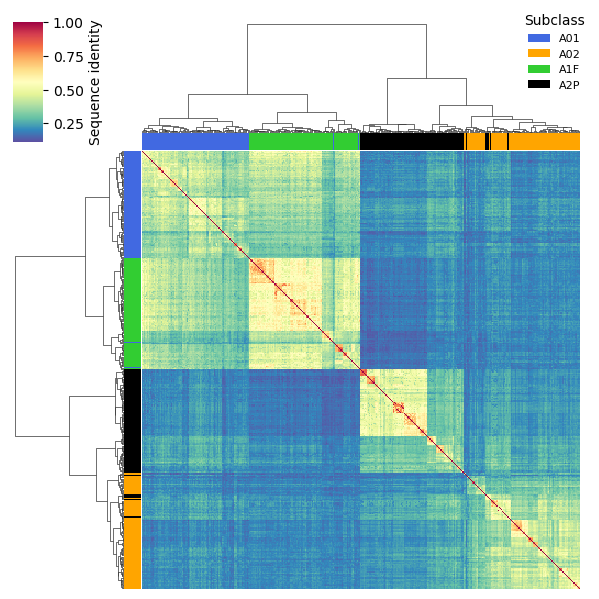

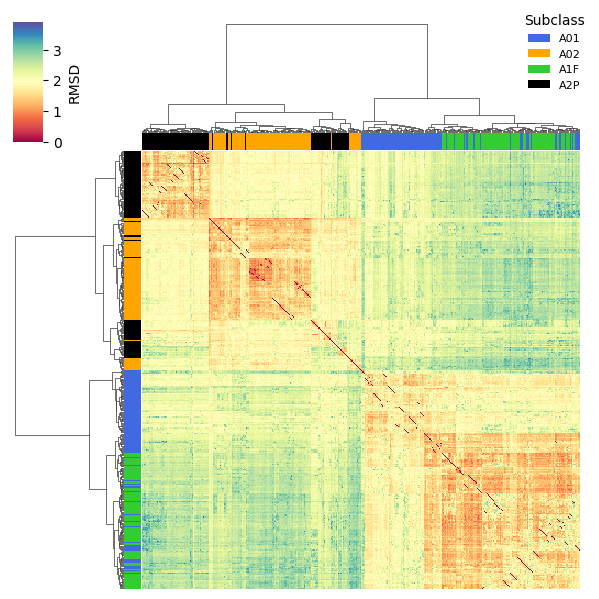

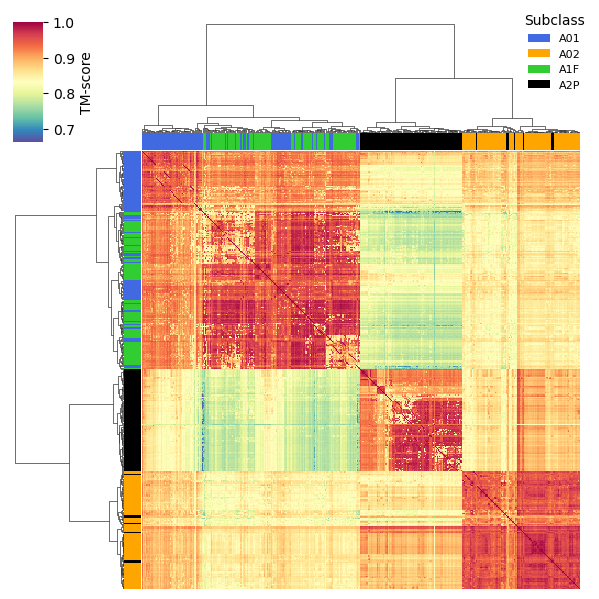

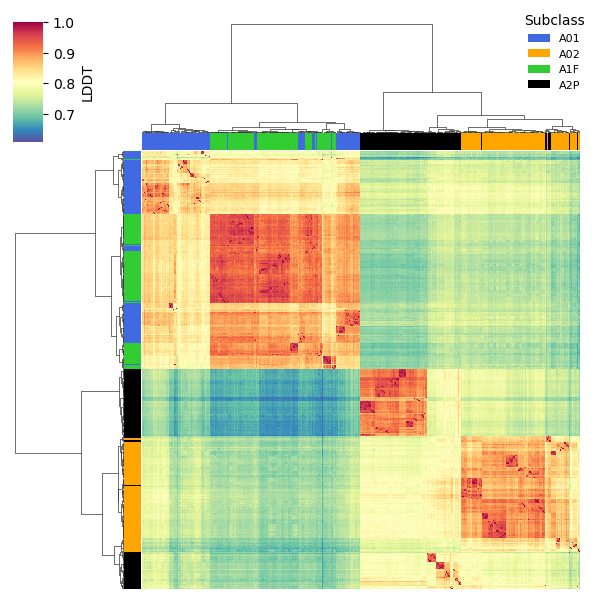

In [43]:
foldseek2 = foldseek[(foldseek['query'] != 'A1F-AF-A0A2A8HHI3-F1-model_v4.pdb') & (foldseek['target'] != 'A1F-AF-A0A2A8HHI3-F1-model_v4.pdb')]

plot_clustermap(foldseek2, 'fident', 'Sequence identity', "Spectral_r")
plot_clustermap(foldseek2, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(foldseek2, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(foldseek2, 'lddt', 'LDDT', "Spectral_r")

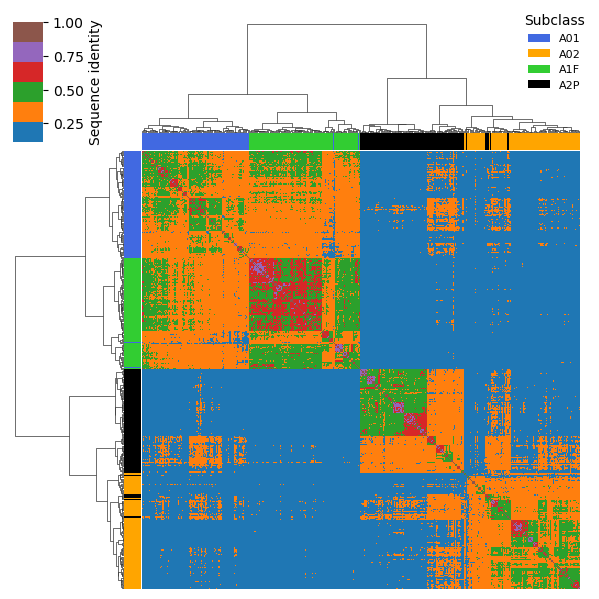

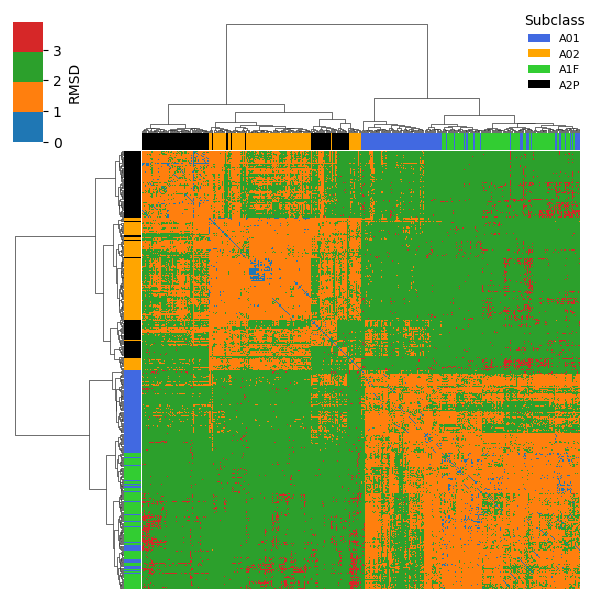

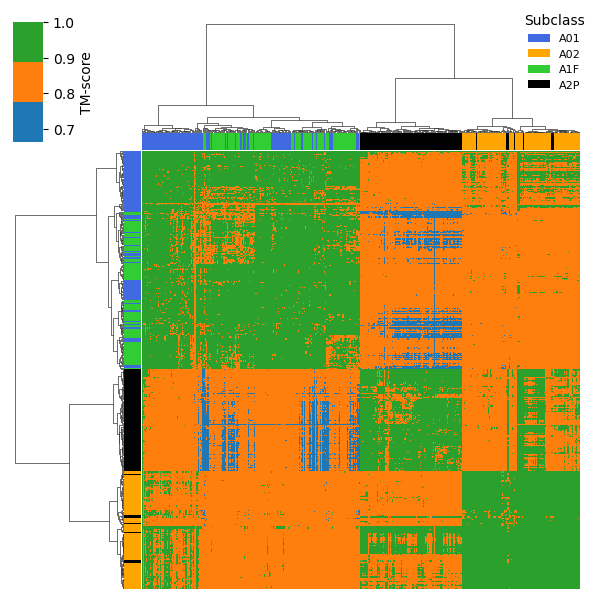

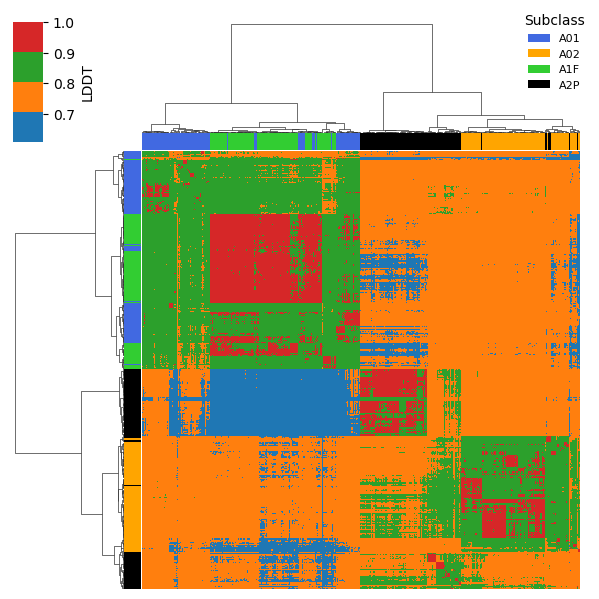

In [44]:
plot_clustermap(foldseek2, 'fident', 'Sequence identity', sns.color_palette("tab10", 10)[:6])
plot_clustermap(foldseek2, 'rmsd', 'RMSD', sns.color_palette("tab10", 10)[:4])
plot_clustermap(foldseek2, 'alntmscore', 'TM-score', sns.color_palette("tab10", 10)[:3])
plot_clustermap(foldseek2, 'lddt', 'LDDT', sns.color_palette("tab10", 10)[:4])

In [45]:
folds = pd.read_csv("/home/gama/desk/bla/bldb/af2/class_a/rep90/search/foldseek_results.csv", sep="\t", names=foldseek_cols)
folds

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,AF-A0A367F4D4-F1-model_v4.pdb,AF-A0A367F4D4-F1-model_v4.pdb,0.01612,1.0000,1.000,1.0000,1.0000,0,0.000
1,AF-A0A367F4D4-F1-model_v4.pdb,AF-A0A109N1U7-F1-model_v4.pdb,2.48300,0.9192,0.407,0.8774,0.8986,88,0.995
2,AF-A0A367F4D4-F1-model_v4.pdb,AF-A0A1H9R4Z9-F1-model_v4.pdb,2.81300,0.9243,0.603,0.9372,0.8973,87,0.994
3,AF-A0A367F4D4-F1-model_v4.pdb,AF-I1D1I3-F1-model_v4.pdb,1.60800,0.9622,0.384,0.8907,0.8962,87,0.994
4,AF-A0A367F4D4-F1-model_v4.pdb,AF-A0A1H9LF45-F1-model_v4.pdb,2.68900,0.9193,0.341,0.8720,0.8961,90,0.996
...,...,...,...,...,...,...,...,...,...
5934091,AF-A0A347UWX4-F1-model_v4.pdb,AF-A0A2W6WDF4-F1-model_v4.pdb,2.20900,0.9200,0.275,0.8016,0.7463,85,0.992
5934092,AF-A0A347UWX4-F1-model_v4.pdb,AF-T0HPJ5-F1-model_v4.pdb,2.46200,0.8689,0.190,0.7459,0.7455,85,0.992
5934093,AF-A0A347UWX4-F1-model_v4.pdb,AF-A0A239CY23-F1-model_v4.pdb,2.48100,0.8681,0.203,0.7433,0.7439,85,0.992
5934094,AF-A0A347UWX4-F1-model_v4.pdb,AF-A0A085F0Q8-F1-model_v4.pdb,1.93200,0.7743,0.181,0.7025,0.7432,72,0.949


In [46]:
target_counts = folds['target'].value_counts()

In [47]:
# apply the rename-fx 
folds["query"]  = folds["query"].apply(lambda x: rename_file(x, names_lists))
folds["target"] = folds["target"].apply(lambda x: rename_file(x, names_lists))
folds

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-A0A367F4D4-F1-model_v4.pdb,0.01612,1.0000,1.000,1.0000,1.0000,0,0.000
1,A01-AF-A0A367F4D4-F1-model_v4.pdb,A1F-AF-A0A109N1U7-F1-model_v4.pdb,2.48300,0.9192,0.407,0.8774,0.8986,88,0.995
2,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-A0A1H9R4Z9-F1-model_v4.pdb,2.81300,0.9243,0.603,0.9372,0.8973,87,0.994
3,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-I1D1I3-F1-model_v4.pdb,1.60800,0.9622,0.384,0.8907,0.8962,87,0.994
4,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-A0A1H9LF45-F1-model_v4.pdb,2.68900,0.9193,0.341,0.8720,0.8961,90,0.996
...,...,...,...,...,...,...,...,...,...
5934091,A01-AF-A0A347UWX4-F1-model_v4.pdb,A01-AF-A0A2W6WDF4-F1-model_v4.pdb,2.20900,0.9200,0.275,0.8016,0.7463,85,0.992
5934092,A01-AF-A0A347UWX4-F1-model_v4.pdb,A2P-AF-T0HPJ5-F1-model_v4.pdb,2.46200,0.8689,0.190,0.7459,0.7455,85,0.992
5934093,A01-AF-A0A347UWX4-F1-model_v4.pdb,A2P-AF-A0A239CY23-F1-model_v4.pdb,2.48100,0.8681,0.203,0.7433,0.7439,85,0.992
5934094,A01-AF-A0A347UWX4-F1-model_v4.pdb,A2P-AF-A0A085F0Q8-F1-model_v4.pdb,1.93200,0.7743,0.181,0.7025,0.7432,72,0.949


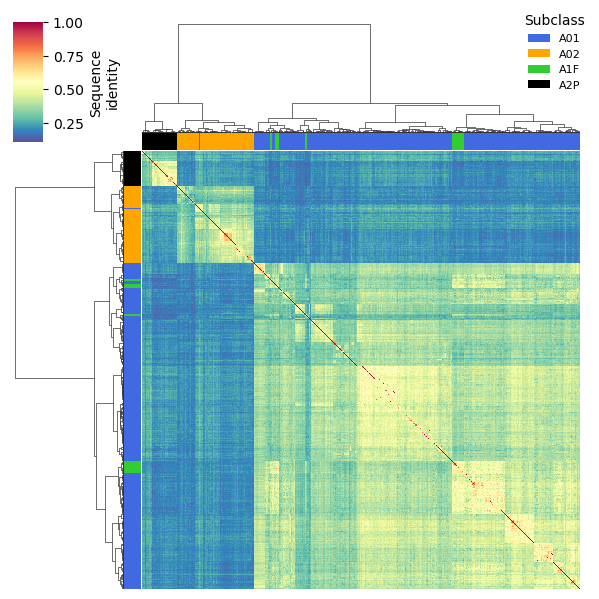

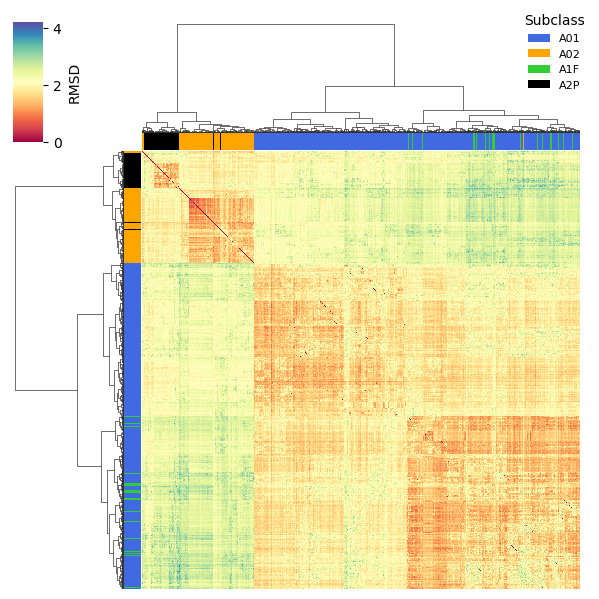

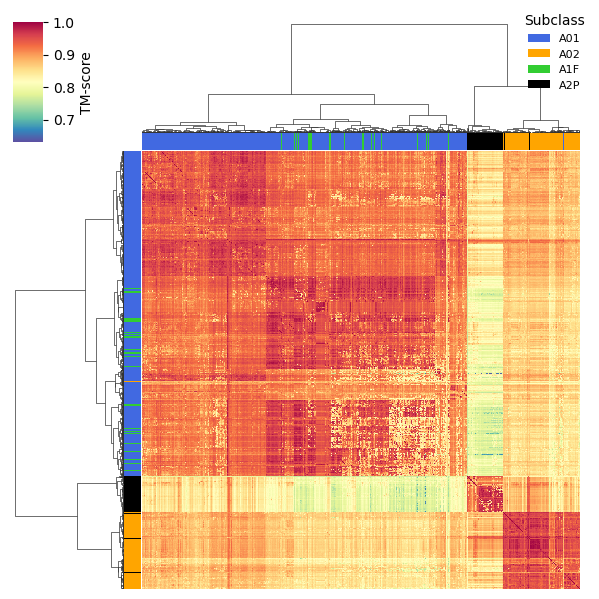

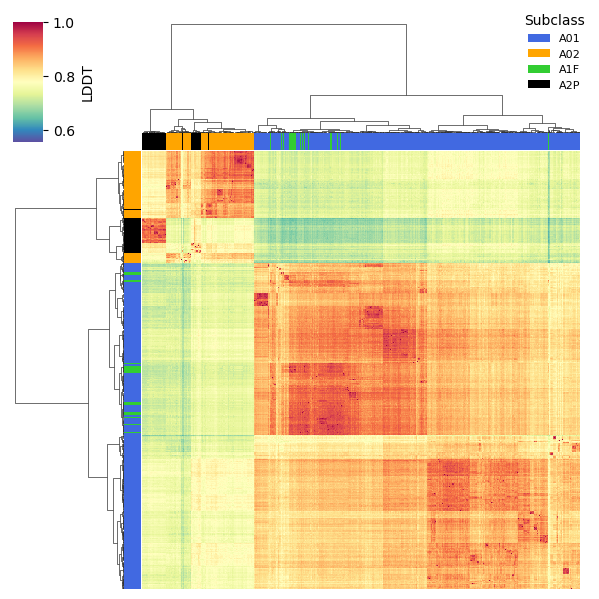

In [48]:
plot_clustermap(folds, 'fident', 'Sequence\nidentity', "Spectral_r")
plot_clustermap(folds, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(folds, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(folds, 'lddt', 'LDDT', "Spectral_r")

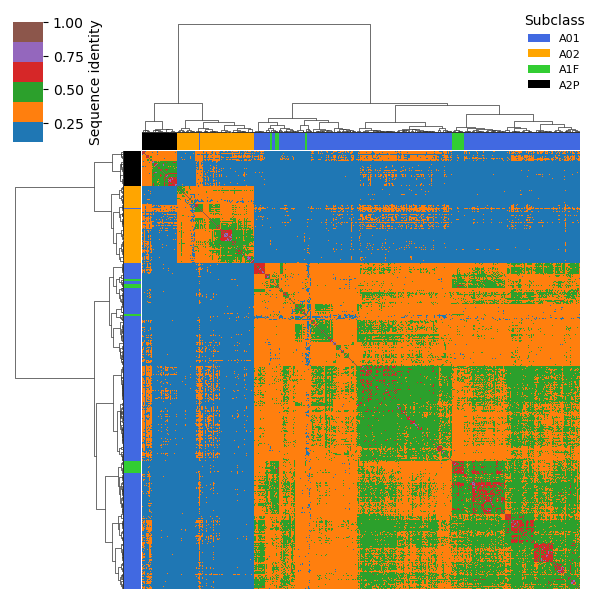

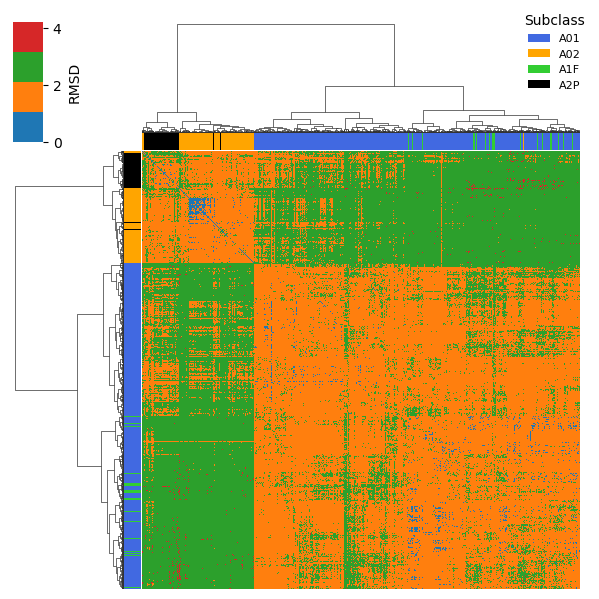

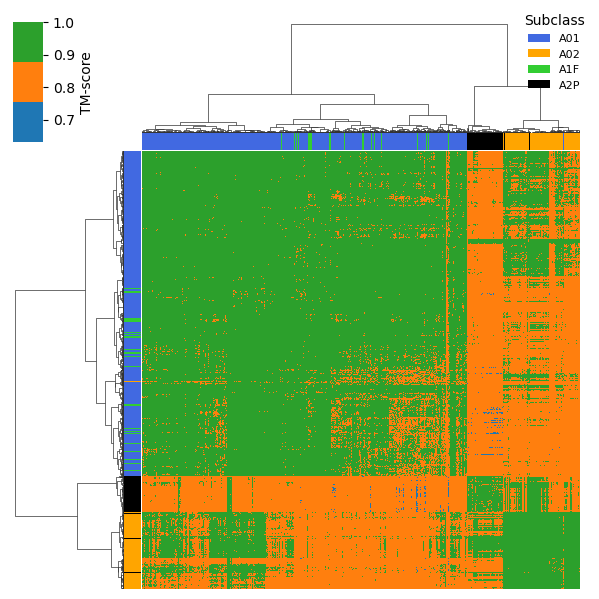

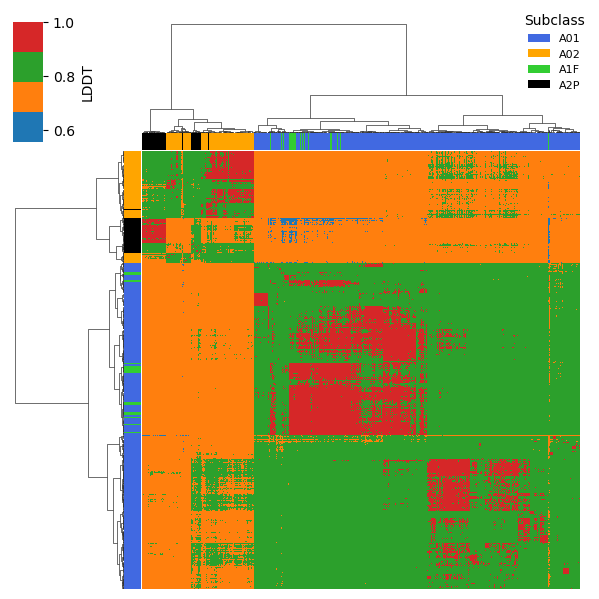

In [49]:
plot_clustermap(folds, 'fident', 'Sequence identity', sns.color_palette("tab10", 10)[:6])
plot_clustermap(folds, 'rmsd', 'RMSD', sns.color_palette("tab10", 10)[:4])
plot_clustermap(folds, 'alntmscore', 'TM-score', sns.color_palette("tab10", 10)[:3])
plot_clustermap(folds, 'lddt', 'LDDT', sns.color_palette("tab10", 10)[:4])

In [50]:
folds[folds.fident < 1.0].sort_values("prob").head()

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
2428686,A01-AF-A0A2W6WDF4-F1-model_v4.pdb,A02-AF-B7BEE4-F1-model_v4.pdb,2.998,0.7631,0.223,0.6063,0.6234,50,0.473
143554,A01-AF-A0A3N6GI37-F1-model_v4.pdb,A02-AF-A0A0N7F1R6-F1-model_v4.pdb,2.571,0.8529,0.164,0.6646,0.6842,53,0.569
2428173,A01-AF-A0A2W6WDF4-F1-model_v4.pdb,A02-AF-A0A0N7F1R6-F1-model_v4.pdb,2.085,0.8804,0.227,0.6938,0.7012,53,0.569
1980384,A01-AF-A0A3M2JDK0-F1-model_v4.pdb,A02-AF-B7BEE4-F1-model_v4.pdb,3.063,0.7952,0.155,0.5614,0.6555,53,0.569
1980467,A01-AF-A0A3M2JDK0-F1-model_v4.pdb,A2P-AF-A0A2V8G4G2-F1-model_v4.pdb,2.485,0.7399,0.218,0.6289,0.6146,53,0.569


In [51]:
# reformat to remoe redundan pairs 
folds2 = folds[folds['query'] != folds['target']]
folds2['sorted_tuple'] = folds2.apply(lambda row: tuple(sorted([row['query'], row['target']])), axis=1)
folds2 = folds2.drop_duplicates(subset='sorted_tuple')
folds2 = folds2.drop(columns='sorted_tuple')
folds2

/tmp/ipykernel_567/892051627.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
1,A01-AF-A0A367F4D4-F1-model_v4.pdb,A1F-AF-A0A109N1U7-F1-model_v4.pdb,2.483,0.9192,0.407,0.8774,0.8986,88,0.995
2,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-A0A1H9R4Z9-F1-model_v4.pdb,2.813,0.9243,0.603,0.9372,0.8973,87,0.994
3,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-I1D1I3-F1-model_v4.pdb,1.608,0.9622,0.384,0.8907,0.8962,87,0.994
4,A01-AF-A0A367F4D4-F1-model_v4.pdb,A01-AF-A0A1H9LF45-F1-model_v4.pdb,2.689,0.9193,0.341,0.8720,0.8961,90,0.996
5,A01-AF-A0A367F4D4-F1-model_v4.pdb,A1F-AF-A0A143HHY9-F1-model_v4.pdb,1.199,0.9683,0.455,0.9135,0.8959,84,0.991
...,...,...,...,...,...,...,...,...,...
5924893,A02-AF-A0A1Q6HCJ8-F1-model_v4.pdb,A01-AF-A0A347UWX4-F1-model_v4.pdb,2.501,0.8586,0.159,0.7222,0.8204,79,0.981
5926365,A02-AF-A0A1Q6HCJ8-F1-model_v4.pdb,A01-AF-A0A263D0W0-F1-model_v4.pdb,2.700,0.8364,0.145,0.7049,0.7642,77,0.975
5927341,A01-AF-A0A263D0W0-F1-model_v4.pdb,A01-AF-A0A347UWX4-F1-model_v4.pdb,2.109,0.9104,0.302,0.8265,0.8393,80,0.984
5928165,A01-AF-A0A263D0W0-F1-model_v4.pdb,A01-AF-A0A2S7DHQ4-F1-model_v4.pdb,1.903,0.9098,0.384,0.8481,0.8175,81,0.986


<Figure size 500x500 with 0 Axes>

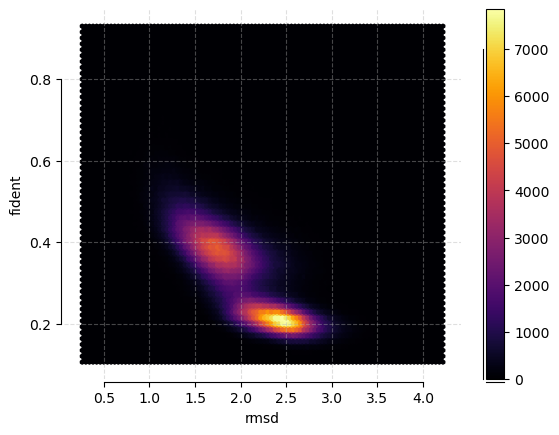

In [52]:
plt.figure(figsize=(5,5))
folds2.plot.hexbin(x='rmsd', y='fident', cmap="inferno")
plt.grid(alpha=0.4, linestyle="--")
sns.despine(trim=True, offset=2)

In [58]:
folds2.query("query.str.contains('A01') and target.str.contains('A01')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,1447551.00,1447551.00,1447551.00,1447551.00,1447551.00,1447551.00,1447551.00
mean,1.77,0.92,0.39,0.85,0.84,83.45,0.99
std,0.35,0.03,0.07,0.04,0.03,4.04,0.01
min,0.30,0.65,0.13,0.63,0.63,55.00,0.63
25%,1.54,0.91,0.35,0.83,0.82,81.00,0.99
50%,1.75,0.93,0.39,0.85,0.84,84.00,0.99
75%,1.98,0.95,0.43,0.88,0.86,86.00,0.99
max,3.92,1.00,0.92,1.00,0.99,99.00,1.00


In [59]:
folds2.query("query.str.contains('A1F') and target.str.contains('A1F')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,6441.00,6441.00,6441.00,6441.00,6441.00,6441.00,6441.00
mean,1.50,0.95,0.50,0.91,0.86,85.18,0.99
std,0.39,0.04,0.10,0.03,0.03,3.31,0.01
min,0.47,0.82,0.23,0.77,0.75,68.00,0.91
25%,1.22,0.93,0.42,0.89,0.84,83.00,0.99
50%,1.43,0.96,0.50,0.92,0.85,85.00,0.99
75%,1.72,0.98,0.57,0.94,0.87,87.00,0.99
max,3.08,1.00,0.91,0.99,0.97,98.00,1.00


In [67]:
folds2.query("query.str.contains('A01|A1F') and target.str.contains('A01|A1F')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,1644391.00,1644391.00,1644391.00,1644391.00,1644391.00,1644391.00,1644391.00
mean,1.77,0.92,0.39,0.85,0.84,83.40,0.99
std,0.35,0.03,0.07,0.04,0.03,3.98,0.01
min,0.30,0.65,0.13,0.63,0.63,55.00,0.63
25%,1.54,0.91,0.35,0.83,0.82,81.00,0.99
50%,1.76,0.93,0.39,0.85,0.84,84.00,0.99
75%,1.98,0.95,0.43,0.88,0.86,86.00,0.99
max,3.92,1.00,0.92,1.00,0.99,99.00,1.00


In [60]:
folds2.query("query.str.contains('A02') and target.str.contains('A02')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,90951.00,90951.00,90951.00,90951.00,90951.00,90951.00,90951.00
mean,1.59,0.94,0.37,0.87,0.89,88.80,0.99
std,0.38,0.03,0.09,0.05,0.04,4.88,0.01
min,0.26,0.74,0.12,0.57,0.67,60.00,0.77
25%,1.36,0.93,0.31,0.85,0.87,86.00,0.99
50%,1.57,0.95,0.36,0.87,0.89,89.00,1.00
75%,1.80,0.96,0.42,0.90,0.92,92.00,1.00
max,3.45,1.00,0.91,1.00,1.00,99.00,1.00


In [61]:
folds2.query("query.str.contains('A2P') and target.str.contains('A2P')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,24090.00,24090.00,24090.00,24090.00,24090.00,24090.00,24090.00
mean,1.88,0.91,0.38,0.83,0.81,80.90,0.98
std,0.47,0.05,0.13,0.07,0.04,6.13,0.03
min,0.42,0.74,0.13,0.64,0.67,61.00,0.80
25%,1.51,0.88,0.28,0.78,0.80,78.00,0.98
50%,1.90,0.92,0.33,0.82,0.82,82.00,0.99
75%,2.21,0.96,0.48,0.90,0.84,85.00,0.99
max,3.91,1.00,0.93,0.99,0.98,99.00,1.00


In [62]:
folds2.query("query.str.contains('A01') and target.str.contains('A1F')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,102736.00,102736.00,102736.00,102736.00,102736.00,102736.00,102736.00
mean,1.78,0.92,0.37,0.85,0.84,83.42,0.99
std,0.37,0.03,0.07,0.04,0.03,3.58,0.01
min,0.59,0.72,0.16,0.63,0.67,58.00,0.72
25%,1.53,0.91,0.32,0.82,0.82,82.00,0.99
50%,1.78,0.92,0.36,0.85,0.84,84.00,0.99
75%,2.01,0.95,0.41,0.88,0.85,86.00,0.99
max,3.59,0.99,0.66,0.98,0.96,98.00,1.00


In [63]:
folds2.query("query.str.contains('A01') and target.str.contains('A02')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,371607.00,371607.00,371607.00,371607.00,371607.00,371607.00,371607.00
mean,2.43,0.87,0.21,0.75,0.81,80.14,0.98
std,0.28,0.03,0.04,0.03,0.03,4.40,0.02
min,0.56,0.65,0.11,0.55,0.62,50.00,0.47
25%,2.26,0.85,0.19,0.73,0.78,77.00,0.98
50%,2.43,0.87,0.21,0.75,0.81,81.00,0.99
75%,2.60,0.88,0.23,0.77,0.83,83.00,0.99
max,4.02,0.99,0.84,0.97,0.97,99.00,1.00


In [64]:
folds2.query("query.str.contains('A01') and target.str.contains('A2P')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,174707.00,174707.00,174707.00,174707.00,174707.00,174707.00,174707.00
mean,2.31,0.83,0.23,0.75,0.75,80.01,0.98
std,0.33,0.04,0.05,0.04,0.04,4.34,0.02
min,0.56,0.63,0.11,0.63,0.61,53.00,0.57
25%,2.08,0.79,0.20,0.73,0.72,77.00,0.98
50%,2.30,0.83,0.22,0.75,0.75,81.00,0.99
75%,2.52,0.85,0.25,0.77,0.78,83.00,0.99
max,4.22,0.99,0.83,0.99,0.96,98.00,1.00


In [66]:
folds2.query("query.str.contains('A01|A1F') and target.str.contains('A2P')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,185325.00,185325.00,185325.00,185325.00,185325.00,185325.00,185325.00
mean,2.32,0.83,0.23,0.75,0.75,79.85,0.98
std,0.33,0.04,0.05,0.04,0.04,4.34,0.02
min,0.56,0.63,0.11,0.63,0.61,53.00,0.57
25%,2.10,0.79,0.20,0.72,0.72,77.00,0.98
50%,2.32,0.83,0.22,0.75,0.75,80.00,0.98
75%,2.54,0.85,0.24,0.76,0.77,83.00,0.99
max,4.22,0.99,0.90,0.99,0.96,98.00,1.00


In [65]:
folds2.query("query.str.contains('A02') and target.str.contains('A2P')").describe().round(2)

,rmsd,alntmscore,fident,lddt,evalue,bits,prob
count,42788.00,42788.00,42788.00,42788.00,42788.00,42788.00,42788.00
mean,2.00,0.87,0.24,0.79,0.79,84.78,0.99
std,0.28,0.03,0.04,0.03,0.04,3.89,0.01
min,0.62,0.74,0.12,0.67,0.66,61.00,0.80
25%,1.83,0.85,0.21,0.78,0.77,83.00,0.99
50%,1.96,0.87,0.23,0.80,0.79,86.00,0.99
75%,2.12,0.89,0.26,0.81,0.81,87.00,0.99
max,3.94,0.99,0.80,0.98,0.99,99.00,1.00


# foldseek cluster

/tmp/ipykernel_6536/2095109191.py:5: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.



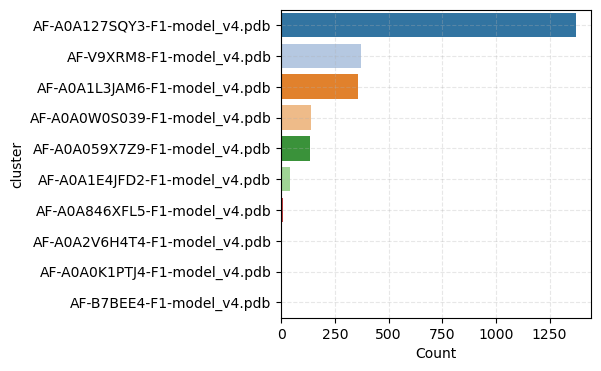

In [113]:
df_clusters =  pd.read_csv("../bldb/af2/class_a/rep90/cluster/foldseek_cluster_tmalign90_3di_cluster.tsv", 
                           sep = "\t", names=["cluster", "member"])

plt.figure(figsize = (4, 4)) 
sns.countplot(data = df_clusters, y = "cluster", order = pd.value_counts(df_clusters.cluster).index, palette="tab20")
plt.xlabel("Count")
plt.grid(alpha = 0.3, linestyle = "--")

In [114]:
df_clust_counts = df_clusters.value_counts("cluster").to_frame().reset_index()
df_clust_counts = df_clust_counts.rename(columns={0:"count"})
df_clust_counts.head(10)

,cluster,count
0,AF-A0A127SQY3-F1-model_v4.pdb,1375
1,AF-V9XRM8-F1-model_v4.pdb,374
2,AF-A0A1L3JAM6-F1-model_v4.pdb,357
3,AF-A0A0W0S039-F1-model_v4.pdb,141
4,AF-A0A059X7Z9-F1-model_v4.pdb,133
5,AF-A0A1E4JFD2-F1-model_v4.pdb,39
6,AF-A0A846XFL5-F1-model_v4.pdb,9
7,AF-A0A2V6H4T4-F1-model_v4.pdb,4
8,AF-A0A0K1PTJ4-F1-model_v4.pdb,3
9,AF-B7BEE4-F1-model_v4.pdb,1


In [115]:
cluster_dict = {}

# Iterar sobre las filas del DataFrame
for index, row in df_clusters.iterrows():
    cluster = row['cluster']
    member = row['member']
    
    # Si el cluster aún no está en el diccionario, agregarlo con una lista vacía
    if cluster not in cluster_dict:
        cluster_dict[cluster] = []
    
    # Agregar el miembro al cluster correspondiente en el diccionario
    cluster_dict[cluster].append(member)

# Función para obtener la lista de miembros dado un cluster
def get_members(cluster_name):
    return cluster_dict.get(cluster_name, [])

In [116]:
cluster_1 = get_members(df_clust_counts.cluster.unique()[0])
cluster_2 = get_members(df_clust_counts.cluster.unique()[1])
cluster_3 = get_members(df_clust_counts.cluster.unique()[2])
cluster_4 = get_members(df_clust_counts.cluster.unique()[3])

conditions = [
    af2_90.model.isin(cluster_1),
    af2_90.model.isin(cluster_2),
    af2_90.model.isin(cluster_3),
    af2_90.model.isin(cluster_4),
]

values = ["cluster_1", "cluster_2", "cluster_3" , "cluster_4"]

af2_90["foldseek_cluster"]  = np.select(conditions, values)
af2_90["foldseek_cluster"]  = af2_90["foldseek_cluster"].replace("0", "singleton")

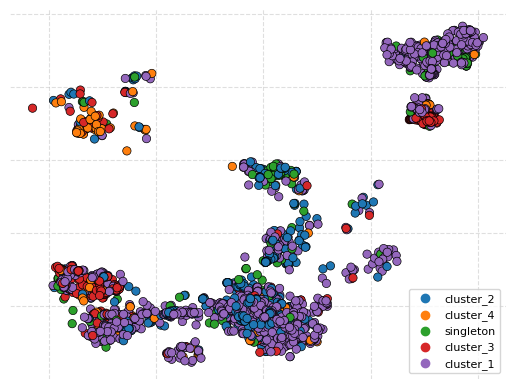

In [117]:
x="tsne1_esm1b_400"
y="tsne2_esm1b_400"


ax = sns.scatterplot(af2_90, x=x, y=y, edgecolor="k", hue="foldseek_cluster")
ax.grid(alpha=0.4, linestyle="--")
ax.set_frame_on(False)
ax.legend(frameon=True, fontsize=8)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_ylabel("")
ax.set_xlabel("")
ax.tick_params(axis='both', colors='white')
ax.set_axisbelow(True)

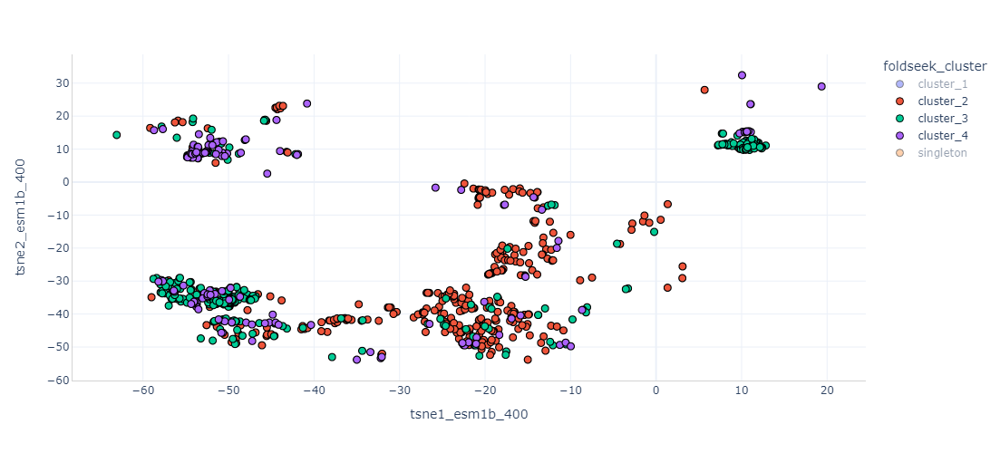

In [118]:
do_iscatter(af2_90.sort_values("foldseek_cluster"), x=x, y=y, hue="foldseek_cluster", 
            hover_name="protein_name", hover_data=["#name", "length"])

In [49]:
# def validate_pdb(directory_path):
#     # Lista para almacenar los nombres de los archivos que no pasan la validación
#     not_pass = []
# 
#     # Obtener la lista de archivos en el directorio
#     files = os.listdir(directory_path)
# 
#     # Filtrar solo los archivos .pdb
#     pdb_files = [file for file in files if file.endswith(".pdb")]
# 
#     # Validar cada archivo .pdb
#     for pdb_file in pdb_files:
#         file_path = os.path.join(directory_path, pdb_file)
#         with open(file_path, "r") as f:
#             # Leer la primera línea del archivo y verificar si contiene "HEADER"
#             first_line = f.readline().strip()
#             if "HEADER" not in first_line:
#                 not_pass.append(pdb_file)
# 
#     return not_pass
# 
# not_pass_list = validate_pdb(directory_path="../bldb/af2/class_a_rep90_rand100")
# not_pass_list